In [86]:
# pip install dask[dataframe]

In [87]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon
from scipy.spatial import KDTree
import numpy as np

# Additional imports
import pystac_client
import xarray as xr
import pathlib
import os
import geopandas as gpd
import matplotlib as mpl
from matplotlib import colors
import rasterio

import cartopy.crs as ccrs
import cartopy
import plotly.graph_objects as go
import plotly.express as px
from rasterio.plot import show

import matplotlib.colors as mcolors
from shapely.geometry import Point
import pandas as pd

from tqdm import tqdm

import webbrowser
from pathlib import Path
import os
import time

from itertools import compress
import pandas as pd

import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy
import plotly.graph_objects as go
import plotly.express as px

from tqdm import tqdm

from shapely.geometry import box
import dask


In [88]:
# opening STAC catalog, either a url, cloud storage link or a local (cloned) folder
cwd = pathlib.Path().resolve()

catalog = pystac_client.Client.open(
    "https://storage.googleapis.com/dgds-data-public/gca/SOTC/gca-stac_sotc/catalog.json" # cloud API
    #os.path.join(os.path.dirname(cwd), "stac_folder", "current", "catalog.json") # local clone 
)
catalog

<Client id=gca-catalog>

In [89]:
list(catalog.get_children())

[<CollectionClient id=shore_mon_fut>,
 <CollectionClient id=sed_class>,
 <CollectionClient id=shore_mon>,
 <CollectionClient id=world_pop>,
 <CollectionClient id=world_gdp>,
 <CollectionClient id=shore_mon_hr>,
 <CollectionClient id=shore_mon_drivers>,
 <CollectionClient id=esl_gwl>,
 <CollectionClient id=sub_threat>,
 <CollectionClient id=Exp_world_pop>,
 <CollectionClient id=Exp_world_pop_parquet>,
 <CollectionClient id=Haz-ESL>,
 <CollectionClient id=Vul-Inf_Mort>,
 <CollectionClient id=Haz-GCM_90-100>,
 <CollectionClient id=Exp-NS_Slopes>,
 <CollectionClient id=Vul_MYS>,
 <CollectionClient id=Vul_RS>,
 <CollectionClient id=Haz-GCM_40-50>,
 <CollectionClient id=Haz-ERA5_04-14>,
 <CollectionClient id=Vul-GDP_Cap>,
 <CollectionClient id=Haz-GCM_04-14>,
 <CollectionClient id=Haz-Land_Sub_2010_COGs>,
 <CollectionClient id=Haz-Land_Sub_2040_COGs>,
 <CollectionClient id=Vul-Roads_Density_COGs>,
 <CollectionClient id=Exp-Delta_DEM_COGs>]

In [90]:
collection= catalog.get_child("Exp_world_pop_parquet")
collection

<CollectionClient id=Exp_world_pop_parquet>

In [91]:
href = catalog.get_child("Exp_world_pop_parquet").assets["data"].href
href

'gs://dgds-data-public/gca/SOTC/Exp_world_pop.parquet/*.parquet'

In [92]:
href

'gs://dgds-data-public/gca/SOTC/Exp_world_pop.parquet/*.parquet'

In [93]:
template_df=pd.read_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\All_Datasets\Orig_Datasets\04_Auxillary_files\Arjen_Vector_Template.csv")
template_df.head()

,transect_id,country_id,continent,country_name,Start_lon,Start_lat,Intersect_lon,Intersect_lat,End_lon,End_lat
0,BOX_028_183_0,CHL,South America,Chile,-74.386310,-50.377659,-74.390966,-50.382558,-74.395623,-50.387456
1,BOX_028_183_1,CHL,South America,Chile,-74.382469,-50.379144,-74.387125,-50.384042,-74.391782,-50.388940
2,BOX_028_183_2,CHL,South America,Chile,-74.378628,-50.380629,-74.383284,-50.385527,-74.387941,-50.390425
3,BOX_028_183_3,CHL,South America,Chile,-74.373950,-50.382583,-74.379517,-50.387079,-74.385083,-50.391574
4,BOX_028_183_4,CHL,South America,Chile,-74.370425,-50.384358,-74.375991,-50.388853,-74.381558,-50.393348


In [94]:

circle_center_all = gpd.GeoDataFrame(
    template_df, geometry=gpd.points_from_xy(template_df.Intersect_lon, template_df.Intersect_lat), crs="EPSG:4326"
)
circle_center_all.head()

,transect_id,country_id,continent,country_name,Start_lon,Start_lat,Intersect_lon,Intersect_lat,End_lon,End_lat,geometry
0,BOX_028_183_0,CHL,South America,Chile,-74.386310,-50.377659,-74.390966,-50.382558,-74.395623,-50.387456,POINT (-74.39097 -50.38256)
1,BOX_028_183_1,CHL,South America,Chile,-74.382469,-50.379144,-74.387125,-50.384042,-74.391782,-50.388940,POINT (-74.38713 -50.38404)
2,BOX_028_183_2,CHL,South America,Chile,-74.378628,-50.380629,-74.383284,-50.385527,-74.387941,-50.390425,POINT (-74.38328 -50.38553)
3,BOX_028_183_3,CHL,South America,Chile,-74.373950,-50.382583,-74.379517,-50.387079,-74.385083,-50.391574,POINT (-74.37952 -50.38708)
4,BOX_028_183_4,CHL,South America,Chile,-74.370425,-50.384358,-74.375991,-50.388853,-74.381558,-50.393348,POINT (-74.37599 -50.38885)


In [95]:
IPCC=gpd.read_file(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\All_Datasets\Orig_Datasets\04_Auxillary_files\IPCC-WGI-reference-regions-v4.gpkg")
IPCC.head()

,Continent,Type,Name,Acronym,geometry
0,POLAR,Land,Greenland/Iceland,GIC,"MULTIPOLYGON (((-10.00000 62.00000, -10.43750 ..."
1,NORTH-AMERICA,Land,N.W.North-America,NWN,"MULTIPOLYGON (((-105.00000 50.00000, -105.4386..."
2,NORTH-AMERICA,Land,N.E.North-America,NEN,"MULTIPOLYGON (((-50.00000 50.00000, -50.44000 ..."
3,NORTH-AMERICA,Land,W.North-America,WNA,"MULTIPOLYGON (((-130.00000 50.00000, -129.5614..."
4,NORTH-AMERICA,Land,C.North-America,CNA,"MULTIPOLYGON (((-90.00000 50.00000, -90.00000 ..."


In [96]:
region_acronym= "CAR"
region_gdf=IPCC.loc[IPCC["Acronym"]==region_acronym,:]
region_gdf


,Continent,Type,Name,Acronym,geometry
8,CENTRAL-AMERICA,Land-Ocean,Caribbean,CAR,"MULTIPOLYGON (((-75.00000 12.00000, -75.32609 ..."


In [97]:

# circle_center=region_gdf.sjoin(circle_center_all)
circle_center=circle_center_all.sjoin(region_gdf)
circle_center=circle_center.iloc[:,0:11]
circle_center.index=range(0,len(circle_center.index))
circle_center

,transect_id,country_id,continent,country_name,Start_lon,Start_lat,Intersect_lon,Intersect_lat,End_lon,End_lat,geometry
0,BOX_116_353_2,COL,South America,Colombia,-71.874132,12.257491,-71.879805,12.250684,-71.885477,12.243877,POINT (-71.87980 12.25068)
1,BOX_116_353_3,COL,South America,Colombia,-71.869660,12.252394,-71.876981,12.247308,-71.884303,12.242222,POINT (-71.87698 12.24731)
2,BOX_116_353_4,COL,South America,Colombia,-71.866684,12.243923,-71.875632,12.243144,-71.884580,12.242366,POINT (-71.87563 12.24314)
3,BOX_116_353_5,COL,South America,Colombia,-71.866286,12.239551,-71.875233,12.238772,-71.884181,12.237993,POINT (-71.87523 12.23877)
4,BOX_116_353_6,COL,South America,Colombia,-71.865960,12.235759,-71.874835,12.234400,-71.883710,12.233041,POINT (-71.87483 12.23440)
...,...,...,...,...,...,...,...,...,...,...,...
37504,BOX_139_002_61,DOM,North America,Dominican Republic,-71.660191,17.969154,-71.668186,17.965259,-71.676182,17.961363,POINT (-71.66819 17.96526)
37505,BOX_139_002_62,DOM,North America,Dominican Republic,-71.657870,17.964549,-71.666228,17.961418,-71.674587,17.958286,POINT (-71.66623 17.96142)
37506,BOX_139_002_63,DOM,North America,Dominican Republic,-71.656224,17.960573,-71.664583,17.957442,-71.672941,17.954311,POINT (-71.66458 17.95744)
37507,BOX_139_002_64,DOM,North America,Dominican Republic,-71.654578,17.956598,-71.662937,17.953466,-71.671295,17.950335,POINT (-71.66294 17.95347)


In [98]:
template_df=circle_center.iloc[:,0:10]
template_df.index=range(0,len(template_df.index))
template_df

,transect_id,country_id,continent,country_name,Start_lon,Start_lat,Intersect_lon,Intersect_lat,End_lon,End_lat
0,BOX_116_353_2,COL,South America,Colombia,-71.874132,12.257491,-71.879805,12.250684,-71.885477,12.243877
1,BOX_116_353_3,COL,South America,Colombia,-71.869660,12.252394,-71.876981,12.247308,-71.884303,12.242222
2,BOX_116_353_4,COL,South America,Colombia,-71.866684,12.243923,-71.875632,12.243144,-71.884580,12.242366
3,BOX_116_353_5,COL,South America,Colombia,-71.866286,12.239551,-71.875233,12.238772,-71.884181,12.237993
4,BOX_116_353_6,COL,South America,Colombia,-71.865960,12.235759,-71.874835,12.234400,-71.883710,12.233041
...,...,...,...,...,...,...,...,...,...,...
37504,BOX_139_002_61,DOM,North America,Dominican Republic,-71.660191,17.969154,-71.668186,17.965259,-71.676182,17.961363
37505,BOX_139_002_62,DOM,North America,Dominican Republic,-71.657870,17.964549,-71.666228,17.961418,-71.674587,17.958286
37506,BOX_139_002_63,DOM,North America,Dominican Republic,-71.656224,17.960573,-71.664583,17.957442,-71.672941,17.954311
37507,BOX_139_002_64,DOM,North America,Dominican Republic,-71.654578,17.956598,-71.662937,17.953466,-71.671295,17.950335


In [99]:

buffer_circles_gdf = gpd.read_file("Caribbean_buffer_circles_1km.gpkg")
buffer_circles_gdf


,geometry
0,"POLYGON ((-71.87062 12.25078, -71.87066 12.249..."
1,"POLYGON ((-71.86780 12.24740, -71.86783 12.246..."
2,"POLYGON ((-71.86645 12.24324, -71.86648 12.242..."
3,"POLYGON ((-71.86605 12.23887, -71.86609 12.237..."
4,"POLYGON ((-71.86565 12.23450, -71.86569 12.233..."
...,...
37504,"POLYGON ((-71.65875 17.96539, -71.65878 17.964..."
37505,"POLYGON ((-71.65679 17.96155, -71.65683 17.960..."
37506,"POLYGON ((-71.65515 17.95757, -71.65518 17.956..."
37507,"POLYGON ((-71.65350 17.95360, -71.65354 17.952..."


In [100]:

# Extract bounding box coordinates
xmin, ymin, xmax, ymax = buffer_circles_gdf.total_bounds

# Create a bounding box polygon
bbox = Polygon([(xmin, ymin), (xmax, ymin), (xmax, ymax), (xmin, ymax)])

In [101]:
import dask.dataframe as dd
from dask.diagnostics import ProgressBar


# # export to zarr in write mode (to overwrite if exists)

with ProgressBar():


    

    # Read the Parquet file as a Dask DataFrame
    ddf = dd.read_parquet(href,engine='pyarrow')

    # Filter lon and lat columns
    filtered_ddf = ddf[(ddf['xcoord'] >= xmin) & (ddf['xcoord'] <= xmax) & (ddf['ycoord'] >= ymin) & (ddf['ycoord'] <= ymax)]

    # Compute the result
    filtered_df = filtered_ddf.compute()



[########################################] | 100% Completed | 40.36 s


In [102]:

data_points_within_extent = gpd.GeoDataFrame(
    filtered_df, geometry=gpd.points_from_xy(filtered_df.xcoord, filtered_df.ycoord), crs="EPSG:4326"
)
data_points_within_extent

,fid,pop_count,layer,area,perimeter,Tot_pop_count,xcoord,ycoord,geometry
0,1,0,_abw_ppp_2020_UNadj_constrained,1.388889e-06,0.005000,0,-70.053750,12.615833,POINT (-70.05375 12.61583)
1,2,0,_abw_ppp_2020_UNadj_constrained,1.388889e-06,0.005000,0,-70.053750,12.614167,POINT (-70.05375 12.61417)
2,3,2,_abw_ppp_2020_UNadj_constrained,2.083333e-06,0.006667,6,-70.053055,12.607222,POINT (-70.05306 12.60722)
3,4,4,_abw_ppp_2020_UNadj_constrained,6.944444e-07,0.003333,4,-70.047500,12.606667,POINT (-70.04750 12.60667)
4,5,0,_abw_ppp_2020_UNadj_constrained,1.388889e-06,0.005000,0,-70.046250,12.606667,POINT (-70.04625 12.60667)
...,...,...,...,...,...,...,...,...,...
127640,168977622,9,_vir_ppp_2020_UNadj_constrained,6.944444e-07,0.003333,9,-64.877500,17.685000,POINT (-64.87750 17.68500)
127641,168977623,7,_vir_ppp_2020_UNadj_constrained,7.638889e-06,0.020000,77,-64.834848,17.686743,POINT (-64.83485 17.68674)
127642,168977624,5,_vir_ppp_2020_UNadj_constrained,2.777778e-06,0.006667,20,-64.762083,17.684583,POINT (-64.76208 17.68458)
127643,168977625,12,_vir_ppp_2020_UNadj_constrained,6.944444e-07,0.003333,12,-64.903333,17.680000,POINT (-64.90333 17.68000)


In [103]:

buffer_circles = buffer_circles_gdf
buffer_circles




,geometry
0,"POLYGON ((-71.87062 12.25078, -71.87066 12.249..."
1,"POLYGON ((-71.86780 12.24740, -71.86783 12.246..."
2,"POLYGON ((-71.86645 12.24324, -71.86648 12.242..."
3,"POLYGON ((-71.86605 12.23887, -71.86609 12.237..."
4,"POLYGON ((-71.86565 12.23450, -71.86569 12.233..."
...,...
37504,"POLYGON ((-71.65875 17.96539, -71.65878 17.964..."
37505,"POLYGON ((-71.65679 17.96155, -71.65683 17.960..."
37506,"POLYGON ((-71.65515 17.95757, -71.65518 17.956..."
37507,"POLYGON ((-71.65350 17.95360, -71.65354 17.952..."


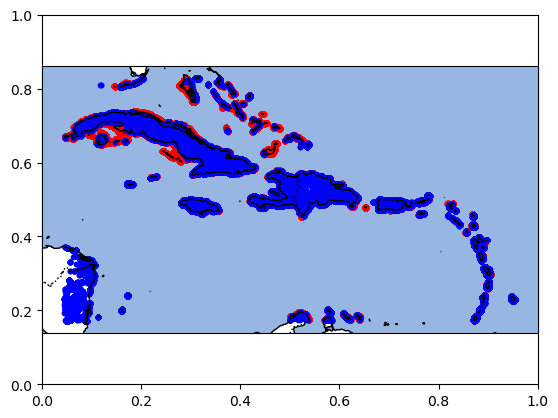

In [104]:





# Step 2: Visualize these 2 geospatial datasets on a map
fig, ax = plt.subplots()
ax = plt.axes(projection=ccrs.PlateCarree())

buffer_circles.boundary.plot(ax=ax, color='green',linewidth=0.005)
circle_center.plot(ax=ax, color='red', markersize=10)
data_points_within_extent.plot(ax=ax, color='blue', markersize=10)



# Add features like coastlines, borders, and ocean
ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS, linestyle=':', edgecolor='black')
ax.add_feature(cartopy.feature.OCEAN)
plt.show()


In [105]:
import warnings

# Suppress all warnings
warnings.filterwarnings("ignore")

for i in tqdm(range(0,len(buffer_circles['geometry'])),desc="Transects checked"):
    #inside_points = data_points[data_points.within(buffer_circles.iloc[i]['geometry'])]
    inside_points = data_points_within_extent[data_points_within_extent.within(buffer_circles.loc[i,'geometry'])]
    
    # Calculate distance
   
#     inside_points.loc[:,'distance'] = inside_points.geometry.distance(circle_center.geometry[i])

#     # Sort inside_points by 'distance' in ascending order
#     sorted_inside_points = inside_points.sort_values(by='distance')

#     # Select the top 2 rows
#     nearest_point = sorted_inside_points.head(1)

    if len(inside_points['geometry'])==0:
            circle_center.loc[i,'sampled points']=0
            circle_center.loc[i,'pop_count']=0
            continue
    
    if len(inside_points['geometry'])>0:
        circle_center.loc[i,'sampled points']=len(inside_points['geometry'])
        circle_center.loc[i,'pop_count']=inside_points["Tot_pop_count"].sum()
        continue
# Suppress all warnings
warnings.filterwarnings("ignore")
circle_center

Transects checked: 100%|██████████| 37509/37509 [33:56<00:00, 18.42it/s]


,transect_id,country_id,continent,country_name,Start_lon,Start_lat,Intersect_lon,Intersect_lat,End_lon,End_lat,geometry,sampled points,pop_count
0,BOX_116_353_2,COL,South America,Colombia,-71.874132,12.257491,-71.879805,12.250684,-71.885477,12.243877,POINT (-71.87980 12.25068),0.0,0.0
1,BOX_116_353_3,COL,South America,Colombia,-71.869660,12.252394,-71.876981,12.247308,-71.884303,12.242222,POINT (-71.87698 12.24731),0.0,0.0
2,BOX_116_353_4,COL,South America,Colombia,-71.866684,12.243923,-71.875632,12.243144,-71.884580,12.242366,POINT (-71.87563 12.24314),0.0,0.0
3,BOX_116_353_5,COL,South America,Colombia,-71.866286,12.239551,-71.875233,12.238772,-71.884181,12.237993,POINT (-71.87523 12.23877),0.0,0.0
4,BOX_116_353_6,COL,South America,Colombia,-71.865960,12.235759,-71.874835,12.234400,-71.883710,12.233041,POINT (-71.87483 12.23440),0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
37504,BOX_139_002_61,DOM,North America,Dominican Republic,-71.660191,17.969154,-71.668186,17.965259,-71.676182,17.961363,POINT (-71.66819 17.96526),44.0,1593.0
37505,BOX_139_002_62,DOM,North America,Dominican Republic,-71.657870,17.964549,-71.666228,17.961418,-71.674587,17.958286,POINT (-71.66623 17.96142),54.0,2227.0
37506,BOX_139_002_63,DOM,North America,Dominican Republic,-71.656224,17.960573,-71.664583,17.957442,-71.672941,17.954311,POINT (-71.66458 17.95744),57.0,2710.0
37507,BOX_139_002_64,DOM,North America,Dominican Republic,-71.654578,17.956598,-71.662937,17.953466,-71.671295,17.950335,POINT (-71.66294 17.95347),51.0,2617.0


In [106]:
circle_center.describe()

,Start_lon,Start_lat,Intersect_lon,Intersect_lat,End_lon,End_lat,sampled points,pop_count
count,37509.000000,37509.000000,37509.000000,37509.000000,37509.000000,37509.000000,37509.000000,37509.000000
mean,-74.929397,20.570424,-74.929338,20.570453,-74.929276,20.570481,7.891279,536.826202
std,6.112249,3.063988,6.112431,3.064050,6.112619,3.064127,19.984230,2473.298379
min,-84.942014,11.996820,-84.950876,12.000458,-84.959783,11.992212,0.000000,0.000000
25%,-79.036895,18.443619,-79.037986,18.447064,-79.038147,18.450788,0.000000,0.000000
50%,-76.242192,21.533002,-76.238532,21.531926,-76.237924,21.531264,0.000000,0.000000
75%,-71.802978,22.683746,-71.803416,22.678425,-71.805816,22.674398,5.000000,139.000000
max,-59.431497,25.007935,-59.422593,24.999901,-59.413637,25.003622,224.000000,88737.000000


In [107]:
circle_center.to_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data\02_Exposure\world_pop\Caribbean_world_pop.csv",index=False)

In [108]:
df=pd.read_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data\02_Exposure\world_pop\Caribbean_world_pop.csv")
df

,transect_id,country_id,continent,country_name,Start_lon,Start_lat,Intersect_lon,Intersect_lat,End_lon,End_lat,geometry,sampled points,pop_count
0,BOX_116_353_2,COL,South America,Colombia,-71.874132,12.257491,-71.879805,12.250684,-71.885477,12.243877,POINT (-71.8798045985 12.250683718),0.0,0.0
1,BOX_116_353_3,COL,South America,Colombia,-71.869660,12.252394,-71.876981,12.247308,-71.884303,12.242222,POINT (-71.87698143850001 12.247308305),0.0,0.0
2,BOX_116_353_4,COL,South America,Colombia,-71.866684,12.243923,-71.875632,12.243144,-71.884580,12.242366,POINT (-71.8756318462 12.2431443263),0.0,0.0
3,BOX_116_353_5,COL,South America,Colombia,-71.866286,12.239551,-71.875233,12.238772,-71.884181,12.237993,POINT (-71.8752334021 12.2387721729),0.0,0.0
4,BOX_116_353_6,COL,South America,Colombia,-71.865960,12.235759,-71.874835,12.234400,-71.883710,12.233041,POINT (-71.8748349513 12.2343999454),0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
37504,BOX_139_002_61,DOM,North America,Dominican Republic,-71.660191,17.969154,-71.668186,17.965259,-71.676182,17.961363,POINT (-71.6681862112 17.9652589019),44.0,1593.0
37505,BOX_139_002_62,DOM,North America,Dominican Republic,-71.657870,17.964549,-71.666228,17.961418,-71.674587,17.958286,POINT (-71.6662284163 17.9614175026),54.0,2227.0
37506,BOX_139_002_63,DOM,North America,Dominican Republic,-71.656224,17.960573,-71.664583,17.957442,-71.672941,17.954311,POINT (-71.664582619 17.9574419454),57.0,2710.0
37507,BOX_139_002_64,DOM,North America,Dominican Republic,-71.654578,17.956598,-71.662937,17.953466,-71.671295,17.950335,POINT (-71.6629367897 17.953466310899998),51.0,2617.0


In [109]:


# Define your discrete color scale
color_scale = ['#D9EAD3', '#A9D08E', '#F9D670', '#FFA94D', '#FF704D', '#FF4D4D']

# Create the scatter mapbox plot using Plotly Graph Objects
fig2 = go.Figure(go.Scattermapbox(
    lat=df['Intersect_lat'],
    lon=df['Intersect_lon'],
    mode='markers',
    marker=dict(
        size=10,
        color=df['pop_count'],  # Use the 'Land_sub' column for color
        # colorscale=color_scale,  # Specify the discrete color scale
        # cmin=1,  # Set the minimum value for the color scale
        # cmax=6,  # Set the maximum value for the color scale
        colorbar=dict(
            title='Total population count'  # Set color bar title
        )
    ),
    hoverinfo='text',
    hovertext=df['pop_count'],
    showlegend=False
))

# Create the scatter mapbox plot using Plotly Graph Objects
fig2.add_trace(go.Scattermapbox(
    lat=data_points_within_extent['ycoord'],
    lon=data_points_within_extent['xcoord'],
    mode='markers',
    marker=dict(
        size=5,
        color='red',  # Set color to red
        # color=data_points_within_extent['Tot_pop_count'],
    ),
    hoverinfo='text',
    hovertext=data_points_within_extent['Tot_pop_count'],
    name='population count datapoints'
))

# Update layout properties
fig2.update_layout(
    title="population count in the Dutch Antilles",
    mapbox_style="carto-positron",
    mapbox=dict(
        zoom=5,
        center=dict(lat=17.9, lon=-71.5)
    ),		

    margin=dict(l=0, r=0, b=0, t=50),
    width=1600,  # Set width to 1000 pixels (10 inches)
    height=800  # Set height to 800 pixels (8 inches)
)

# Show the plot
fig2.show()

